In [1]:
%load_ext autoreload
%autoreload 2

# OpenSlide 

In [2]:
from openslide import OpenSlide

In [3]:
slide = OpenSlide("/data/Robin/AprioricsSlides/slides/21I000004-1-03-1_135435.svs")

In [4]:
dict(slide.properties)

{'aperio.AppMag': '40',
 'aperio.Date': '12/07/2021',
 'aperio.Exposure Scale': '0.000001',
 'aperio.Exposure Time': '8',
 'aperio.Filtered': '3',
 'aperio.Focus Offset': '0.000000',
 'aperio.Gamma': '2.2',
 'aperio.Left': '23.206832885742',
 'aperio.MPP': '0.263223',
 'aperio.Rack': '1',
 'aperio.ScanScope ID': 'SS45033',
 'aperio.Slide': '20',
 'aperio.StripeWidth': '4096',
 'aperio.Time': '13:54:36',
 'aperio.Time Zone': 'GMT+0100',
 'aperio.Top': '41.950263977051',
 'openslide.comment': 'Aperio Leica Biosystems GT450 v1.0.1 \n120784x88164 [0,0,120784x88164] (256x256) JPEG/YCC Q=91|AppMag = 40|Date = 12/07/2021|Exposure Scale = 0.000001|Exposure Time = 8|Filtered = 3|Focus Offset = 0.000000|Gamma = 2.2|Left = 23.206832885742|MPP = 0.263223|Rack = 1|ScanScope ID = SS45033|Slide = 20|StripeWidth = 4096|Time = 13:54:36|Time Zone = GMT+0100|Top = 41.950263977051',
 'openslide.level-count': '4',
 'openslide.level[0].downsample': '1',
 'openslide.level[0].height': '88164',
 'openslide.lev

In [5]:
properties = {"Full size": slide.dimensions, 
              "Number of levels": slide.level_count, 
              "Dimensions for each level": slide.level_dimensions, 
              "Downsamples for each level": slide.level_downsamples}
properties

{'Full size': (120784, 88164),
 'Number of levels': 4,
 'Dimensions for each level': ((120784, 88164),
  (30196, 22041),
  (7549, 5510),
  (1887, 1377)),
 'Downsamples for each level': (1.0,
  4.0,
  16.000362976406535,
  64.01731142907613)}

(1000, 730)


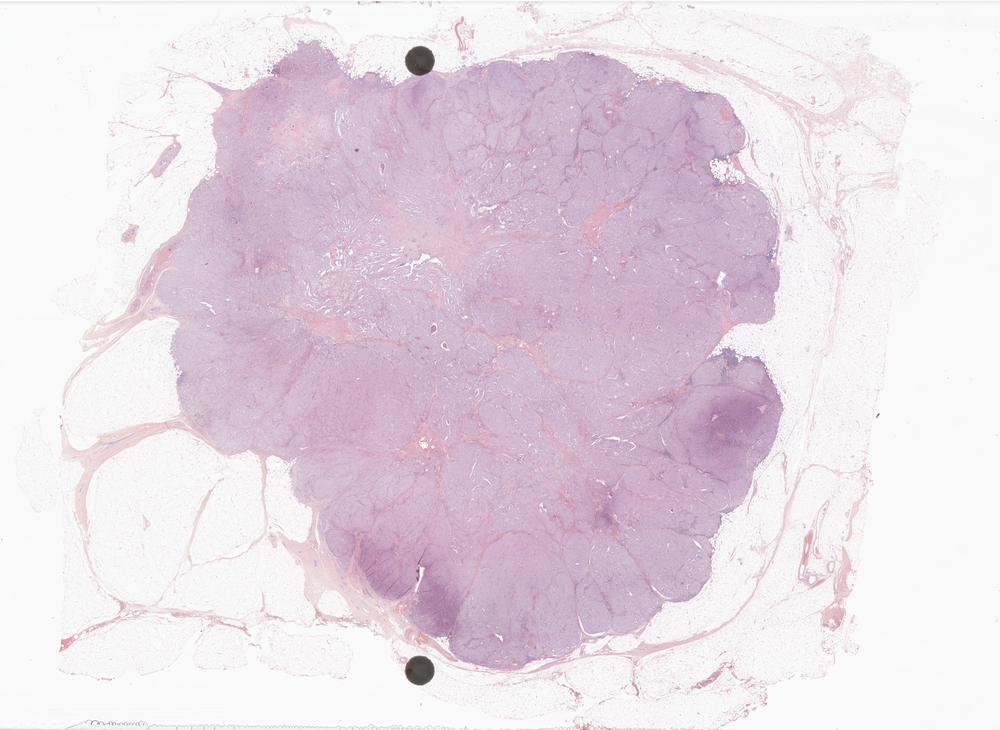

In [6]:
thumb = slide.get_thumbnail((1000, 1000))
print(thumb.size)
thumb

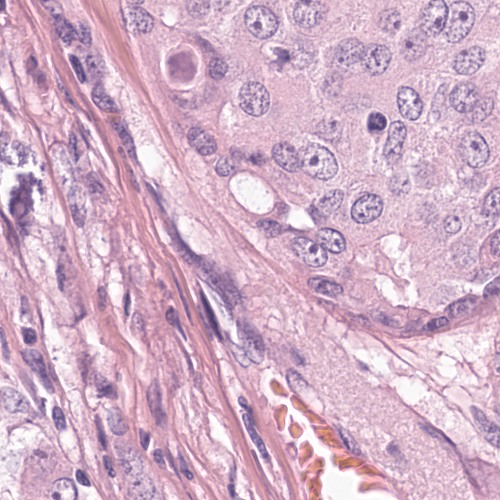

In [7]:
slide.read_region((50000, 50000), 0, (500, 500))

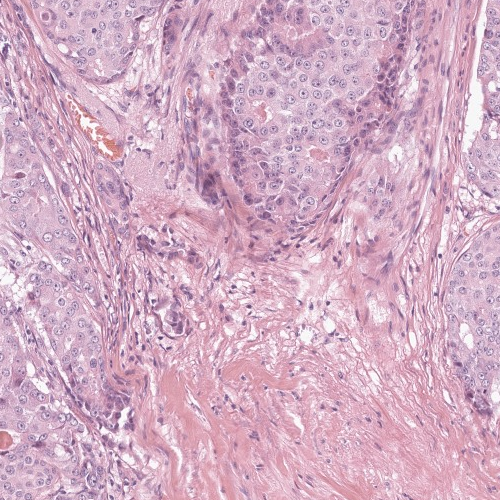

In [8]:
slide.read_region((50000, 50000), 1, (500, 500))

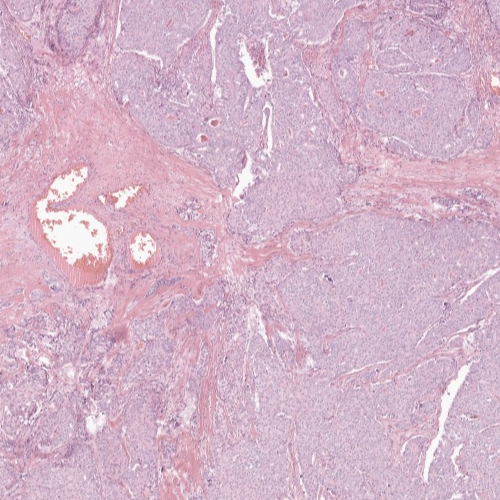

In [9]:
slide.read_region((50000, 50000), 2, (500, 500))

# cuCIM

In [10]:
from cucim import CuImage
import numpy as np
from PIL import Image

In [11]:
slide = CuImage("/data/Robin/AprioricsSlides/slides/21I000004-1-03-1_135435.svs")

In [12]:
slide.metadata

{'aperio': {'AppMag': '40',
  'Date': '12/07/2021',
  'Exposure Scale': '0.000001',
  'Exposure Time': '8',
  'Filtered': '3',
  'Focus Offset': '0.000000',
  'Gamma': '2.2',
  'Header': 'Aperio Leica Biosystems GT450 v1.0.1 \n120784x88164 [0,0,120784x88164] (256x256) JPEG/YCC Q=91',
  'Left': '23.206832885742',
  'MPP': '0.263223',
  'Rack': '1',
  'ScanScope ID': 'SS45033',
  'Slide': '20',
  'StripeWidth': '4096',
  'Time': '13:54:36',
  'Time Zone': 'GMT+0100',
  'Top': '41.950263977051'},
 'cucim': {'associated_images': ['label', 'macro', 'thumbnail'],
  'channel_names': ['R', 'G', 'B'],
  'coord_sys': 'LPS',
  'dims': 'YXC',
  'direction': [[1.0, 0.0, 0.0], [0.0, 1.0, 0.0], [0.0, 0.0, 1.0]],
  'dtype': {'bits': 8, 'code': 1, 'lanes': 1},
  'ndim': 3,
  'origin': [0.0, 0.0, 0.0],
  'path': '/data/Robin/AprioricsSlides/slides/21I000004-1-03-1_135435.svs',
  'resolutions': {'level_count': 4,
   'level_dimensions': [[120784, 88164],
    [30196, 22041],
    [7549, 5510],
    [1887, 13

In [13]:
properties = {"Full size": slide.size("XY"), 
              "Number of levels": slide.resolutions["level_count"], 
              "Dimensions for each level": slide.resolutions["level_dimensions"], 
              "Downsamples for each level": slide.resolutions["level_downsamples"]}
properties

{'Full size': [120784, 88164],
 'Number of levels': 4,
 'Dimensions for each level': ((120784, 88164),
  (30196, 22041),
  (7549, 5510),
  (1887, 1377)),
 'Downsamples for each level': (1.0,
  4.0,
  16.000362396240234,
  64.0173110961914)}

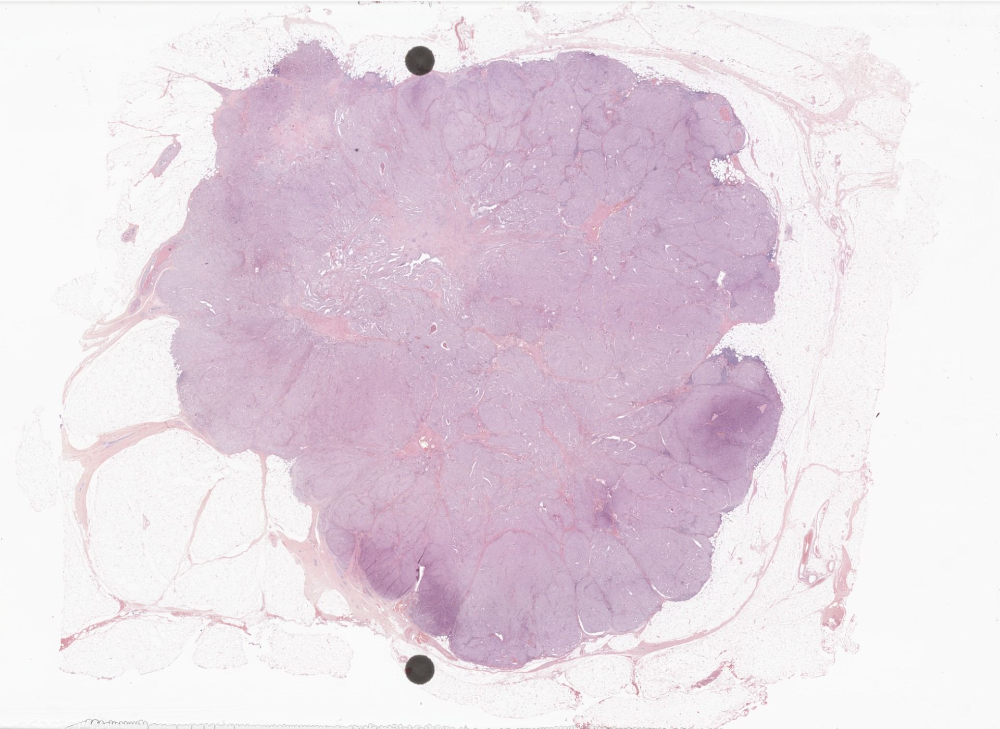

In [14]:
Image.fromarray(np.asarray(slide.associated_image("thumbnail")))

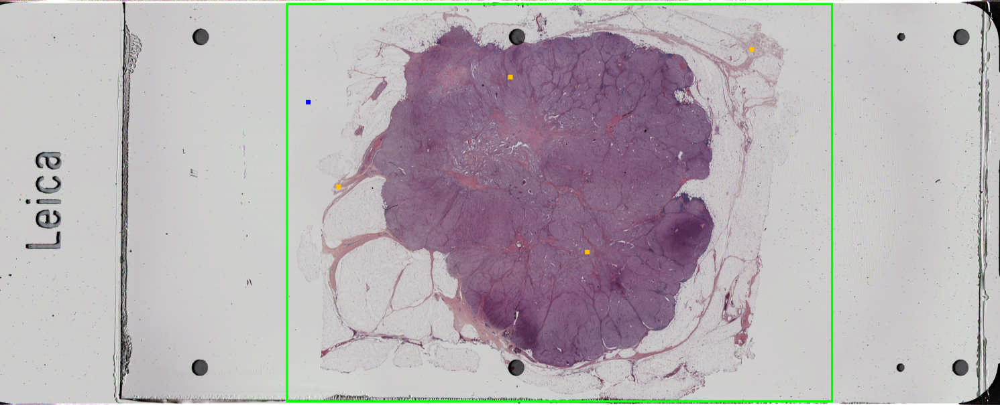

In [15]:
Image.fromarray(np.asarray(slide.associated_image("macro")))

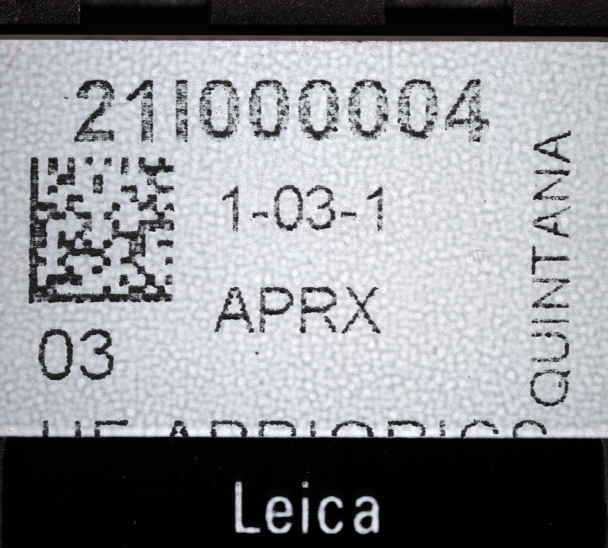

In [16]:
Image.fromarray(np.asarray(slide.associated_image("label")))

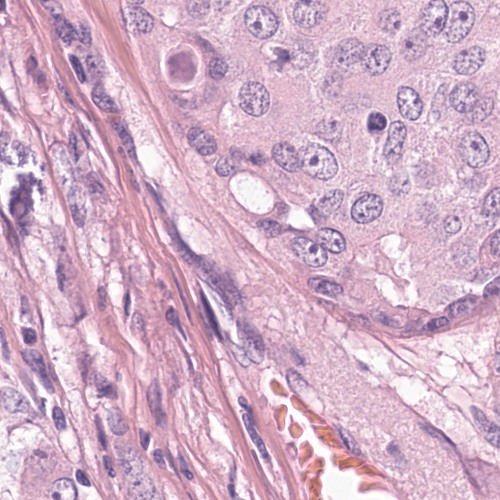

In [17]:
Image.fromarray(np.asarray(slide.read_region((50000, 50000), (500, 500), 0)))

# PathAIA 

## Slide 

In [18]:
from pathaia.util.types import Slide

In [19]:
slide = Slide("/data/Robin/AprioricsSlides/slides/21I000004-1-03-1_135435.svs", backend="cucim")

In [20]:
Slide??

Init signature: Slide(path: Union[str, os.PathLike], backend: str = 'openslide')
Docstring:      <no docstring>
Source:        
class Slide:
    def __init__(self, path: PathLike, backend: str = "openslide"):
        path = Path(path)
        if backend == "openslide":
            opener = OpenSlide
        else:
            if path.suffix not in (".svs", ".tif"):
                warnings.warn(
                    "Cucim backend only works for svs and tiff, switching to openslide."
                )
                opener = OpenSlide
                backend = "openslide"
            else:
                opener = CuImage

        self._slide = opener(str(path))
        self.backend = backend

    @property
    def dimensions(self):
        if self.backend == "openslide":
            return self._slide.dimensions
        else:
            return self._slide.size("XY")

    @property
    def _filename(self):
        if self.backend == "openslide":
            return self._slide._filename

In [21]:
slide.dimensions, slide.size("XY")

([120784, 88164], [120784, 88164])

In [22]:
slide.level_count, slide.resolutions["level_count"]

(4, 4)

## Extraction de patchs 

In [23]:
from pathaia.patches import slide_rois_no_image

In [24]:
patches = list(slide_rois_no_image(slide, 0, 1024))
print("\n".join(map(str, patches[:10])))

Patch(id='#1', slidename='21I000004-1-03-1_135435.svs', position=Coord(x=0, y=0), level=0, size=Coord(x=1024, y=1024), size_0=Coord(x=1024, y=1024), parent=None)
Patch(id='#2', slidename='21I000004-1-03-1_135435.svs', position=Coord(x=1024, y=0), level=0, size=Coord(x=1024, y=1024), size_0=Coord(x=1024, y=1024), parent=None)
Patch(id='#3', slidename='21I000004-1-03-1_135435.svs', position=Coord(x=2048, y=0), level=0, size=Coord(x=1024, y=1024), size_0=Coord(x=1024, y=1024), parent=None)
Patch(id='#4', slidename='21I000004-1-03-1_135435.svs', position=Coord(x=3072, y=0), level=0, size=Coord(x=1024, y=1024), size_0=Coord(x=1024, y=1024), parent=None)
Patch(id='#5', slidename='21I000004-1-03-1_135435.svs', position=Coord(x=4096, y=0), level=0, size=Coord(x=1024, y=1024), size_0=Coord(x=1024, y=1024), parent=None)
Patch(id='#6', slidename='21I000004-1-03-1_135435.svs', position=Coord(x=5120, y=0), level=0, size=Coord(x=1024, y=1024), size_0=Coord(x=1024, y=1024), parent=None)
Patch(id='#7'

In [25]:
from pathaia.util.types import Patch, Coord

In [26]:
Patch??

Init signature:
Patch(
    id: str,
    slidename: str,
    position: pathaia.util.types.Coord,
    level: int,
    size: pathaia.util.types.Coord,
    size_0: pathaia.util.types.Coord,
    parent: Optional[ForwardRef('Patch')] = None,
) -> None
Docstring:      Patch(id: str, slidename: str, position: pathaia.util.types.Coord, level: int, size: pathaia.util.types.Coord, size_0: pathaia.util.types.Coord, parent: Optional[ForwardRef('Patch')] = None)
Source:        
@dataclass(frozen=True)
class Patch:
    id: str
    slidename: str
    position: Coord
    level: int
    size: Coord
    size_0: Coord
    parent: Optional["Patch"] = None

    @classmethod
    def get_fields(cls) -> List[str]:
        return [
            "id",
            "global_id",
            "x",
            "y",
            "level",
            "dx",
            "dy",
            "size_x",
            "size_y",
            "parent",
        ]

    def to_csv_row(self) -> Dict[str, Union[str, int]]:
        return {


In [27]:
print(Coord(1024))
print(Coord(1024, 256))
print(Coord(y=256, x=1024))
print(Coord(1024, 255.7))

Coord(x=1024, y=1024)
Coord(x=1024, y=256)
Coord(x=1024, y=256)
Coord(x=1024, y=255)


In [28]:
coord = Coord(1024, 256)
print(coord * 2)
print(coord + 256)
print(256 - coord)
print(coord / 2)
print(coord / 3)
print(coord + 3 * coord + 128)

Coord(x=2048, y=512)
Coord(x=1280, y=512)
Coord(x=-768, y=0)
Coord(x=512, y=128)
Coord(x=341, y=85)
Coord(x=4224, y=1152)


In [29]:
from pathaia.patches.visu import preview_from_queries

In [30]:
from collections.abc import Iterable

In [31]:
isinstance(slide.dimensions, Iterable)

True

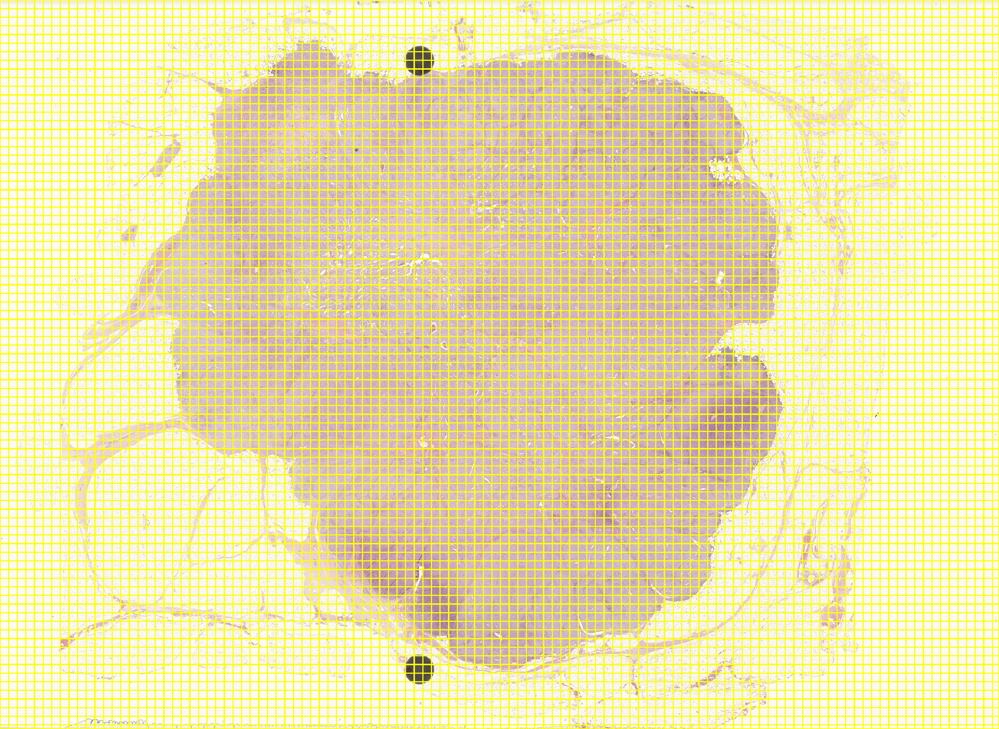

In [33]:
Image.fromarray(preview_from_queries(slide, patches))

In [36]:
patches = list(slide_rois_no_image(slide, 0, 1024, interval=-256))

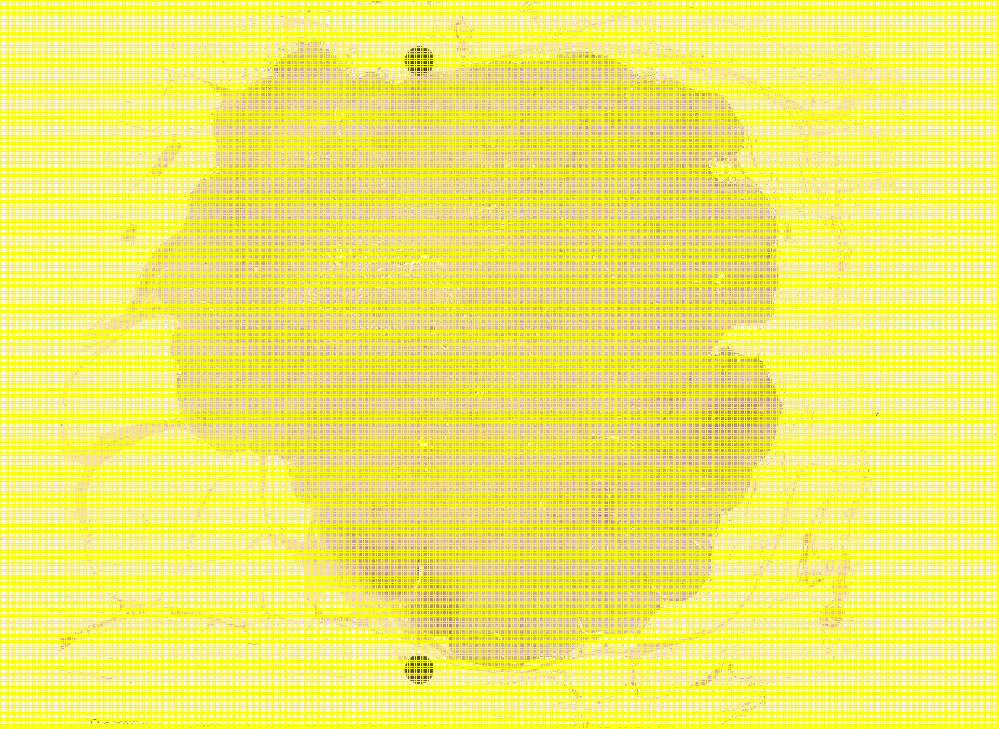

In [37]:
Image.fromarray(preview_from_queries(slide, patches))

In [38]:
patches = list(slide_rois_no_image(slide, 0, 1024, thumb_size=5000, slide_filters="full"))

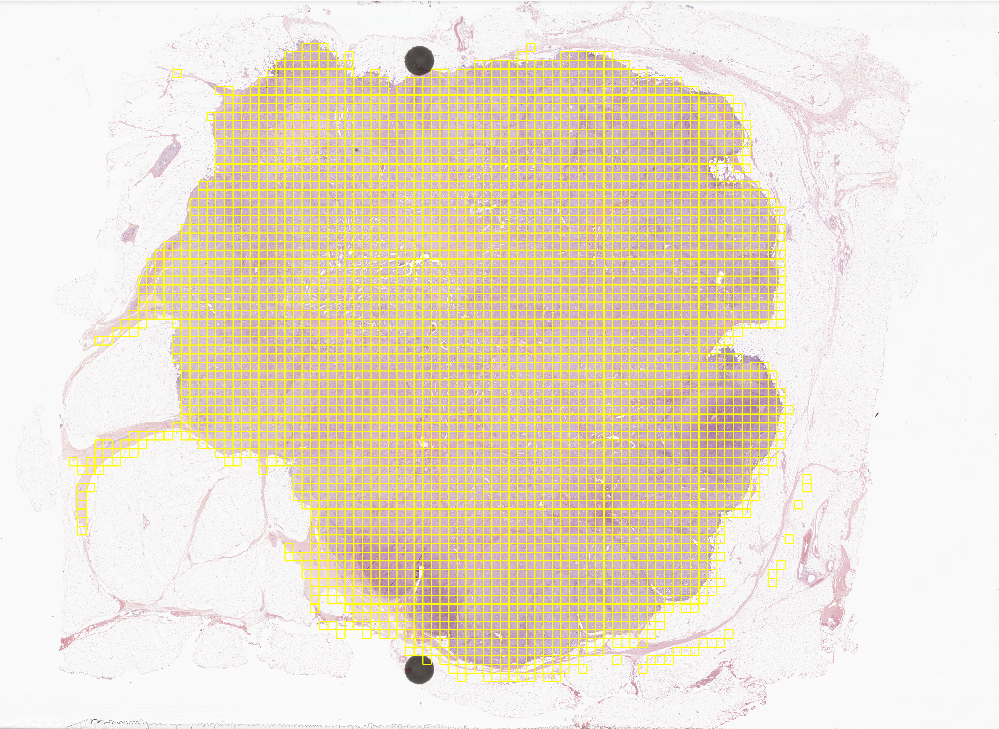

In [39]:
Image.fromarray(preview_from_queries(slide, patches))

## Graphes 

In [47]:
from pathaia.graphs import Graph, UGraph, Tree

On crée un graphe linéaire 0 -> 1 -> 2 -> 3 -> 4

In [45]:
graph = Graph(nodes=range(5), edges=[(0, 1), (1, 2), (2, 3), (3, 4)])

In [50]:
print(graph.n_nodes)
print(graph.nodes)
print(graph.edges)
print(graph.A.toarray().astype(np.uint8))

5
OrderedSet([0, 1, 2, 3, 4])
{(0, 1), (1, 2), (2, 3), (3, 4)}
[[0 1 0 0 0]
 [0 0 1 0 0]
 [0 0 0 1 0]
 [0 0 0 0 1]
 [0 0 0 0 0]]


In [51]:
graph.add_edge((4, 0))
graph.add_edge((2, 1))
graph.remove_edge((0, 1))

In [52]:
print(graph.n_nodes)
print(graph.nodes)
print(graph.edges)
print(graph.A.toarray().astype(np.uint8))

5
OrderedSet([0, 1, 2, 3, 4])
{(4, 0), (1, 2), (3, 4), (2, 1), (2, 3)}
[[0 0 0 0 0]
 [0 0 1 0 0]
 [0 1 0 1 0]
 [0 0 0 0 1]
 [1 0 0 0 0]]


In [53]:
graph = UGraph(nodes=range(5), edges=[(0, 1), (1, 2), (2, 3), (3, 4)])

In [54]:
print(graph.n_nodes)
print(graph.nodes)
print(graph.edges)
print(graph.A.toarray().astype(np.uint8))

5
OrderedSet([0, 1, 2, 3, 4])
{(0, 1), (1, 2), (2, 3), (3, 4)}
[[0 1 0 0 0]
 [1 0 1 0 0]
 [0 1 0 1 0]
 [0 0 1 0 1]
 [0 0 0 1 0]]


In [55]:
graph.add_edge((4, 0))
graph.add_edge((2, 1))
graph.remove_edge((0, 1))

In [56]:
print(graph.n_nodes)
print(graph.nodes)
print(graph.edges)
print(graph.A.toarray().astype(np.uint8))

5
OrderedSet([0, 1, 2, 3, 4])
{(1, 2), (0, 4), (3, 4), (2, 3)}
[[0 0 0 0 1]
 [0 0 1 0 0]
 [0 1 0 1 0]
 [0 0 1 0 1]
 [1 0 0 1 0]]


In [60]:
tree = Tree()

In [61]:
tree.add_edge(0, 1)
tree.add_children(1, (2, 3))
tree.add_children(2, (3, 4))

In [62]:
print(tree.n_nodes)
print(tree.nodes)
print(tree.edges)
print(tree.A.toarray().astype(np.uint8))
print(tree.parents)
print(tree.children)

5
OrderedSet([0, 1, 2, 3, 4])
{(0, 1), (2, 4), (1, 2), (2, 3), (1, 3)}
[[0 1 0 0 0]
 [0 0 1 1 0]
 [0 0 0 1 1]
 [0 0 0 0 0]
 [0 0 0 0 0]]
{1: 0, 2: 1, 3: 2, 4: 2}
{0: {1}, 1: {2, 3}, 2: {3, 4}}


In [63]:
from pathaia.graphs.clustering import AgglomerativeClustering

In [64]:
AgglomerativeClustering??

Init signature: AgglomerativeClustering(compute_all: bool = False)
Source:        
class AgglomerativeClustering:
    r"""
    Object used to hierarchically cluster nodes on a graph. Clustering greedily chooses
    to merge linked nodes that have minimum distance/strength ratio. Strength between
    2 nodes is initially 1 for every edge and 0 when there is no edge, then when 2 nodes
    are merged the strength of a newly formed link between the new node and another node
    is the weighted (by node population) average of the strengths between the 2 old
    nodes and the other node. This algorithm uses centroid linkage clustering (UPGMC).

    Args:
        compute_all: whether to initially compute all distances between nodes regardless
            of there linkage.
    """

    def __init__(self, compute_all: bool = False):
        self.compute_all = compute_all

    def init_graph(
        self,
        G: UGraph,
        feats: Union[Dict[Node, NDArray[(Any,), Any]], Sequence[str]],
